In [1]:
import os
wd = os.path.normpath(os.getcwd() + '/..')
os.chdir(wd)
os.getcwd()

'C:\\Users\\Fitogether\\Workspace\\footballcpd'

In [5]:
import numpy as np
import pandas as pd
from datetime import datetime
import itertools
from collections import Counter
from tqdm import tqdm
from src.myconstants import *
from src.preprocessor import Preprocessor

In [3]:
from scipy.spatial import Delaunay, distance_matrix
from scipy.optimize import linear_sum_assignment
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
%matplotlib inline

In [4]:
pd.set_option('display.width', 250)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 20)

In [7]:
activity_records, player_periods, roster, ugp_df = pp.load_activity_data(1)

In [8]:
player_periods

,type,session,gametime,start_dt,end_dt,duration,player_ids
player_period,,,,,,,
0,MATCH,0,0,2020-01-01 00:00:00,2020-01-01 01:49:00,5640.0,"[5527, 5608, 4650, 5516, 4142, 5488, 4181, 136..."
1,START1,1,00~46,2020-01-01 00:00:00,2020-01-01 00:46:00,2760.0,"[5608, 4650, 5516, 4142, 5488, 4181, 1365, 357..."
2,START2,2,00~13,2020-01-01 01:01:00,2020-01-01 01:14:00,780.0,"[5608, 5516, 4142, 5488, 4181, 1365, 3574, 418..."
3,SUB,2,13~40,2020-01-01 01:14:00,2020-01-01 01:41:00,1620.0,"[5608, 5516, 4142, 5488, 4181, 1365, 4183, 185..."
4,SUB,2,40~48,2020-01-01 01:41:00,2020-01-01 01:49:00,480.0,"[5608, 5516, 4142, 5488, 4181, 1365, 4183, 553..."


In [9]:
ugp_df

,player_id,player_period,session,gametime,unixtime,duration,x,y,speed
2019-12-31 23:26:49.100,1365.0,NaN,NaN,NaN,1.577835e+09,0.1,3362.0,8191.0,0.233274
2019-12-31 23:26:49.200,1365.0,NaN,NaN,NaN,1.577835e+09,0.1,3366.0,8185.0,0.318801
2019-12-31 23:26:49.300,1365.0,NaN,NaN,NaN,1.577835e+09,0.1,3366.0,8181.0,0.369413
2019-12-31 23:26:49.400,1365.0,NaN,NaN,NaN,1.577835e+09,0.1,3364.0,8178.0,0.391145
2019-12-31 23:26:49.500,1365.0,NaN,NaN,NaN,1.577835e+09,0.1,3360.0,8177.0,0.390031
...,...,...,...,...,...,...,...,...,...
2020-01-01 01:58:59.600,5608.0,NaN,NaN,NaN,1.577844e+09,0.1,4381.0,4760.0,5.710166
2020-01-01 01:58:59.700,5608.0,NaN,NaN,NaN,1.577844e+09,0.1,4370.0,4750.0,5.709115
2020-01-01 01:58:59.800,5608.0,NaN,NaN,NaN,1.577844e+09,0.1,4358.0,4740.0,5.708764
2020-01-01 01:58:59.900,5608.0,NaN,NaN,NaN,1.577844e+09,0.1,4347.0,4728.0,5.709465


In [ ]:
from src.match import Match

### Visualizing Role Switches

In [1]:
# fgp_dir = 'data/2020_kleague/fgp'
# for fgp_file in tqdm(os.listdir(fgp_dir)):
#     fgp_path = os.path.join(fgp_dir, fgp_file)
#     fgp_df = pd.read_csv(fgp_path, header=0, encoding='utf-8-sig')
#     fgp_df.to_csv(f"data/2020_kleague/fgp_csv/{fgp_file.split('.')[0]}.csv", index=False, encoding='utf-8-sig')

In [8]:
activity_id = 17985
fgp_path = f'data/2020_kleague/fgp_avg/{activity_id}.csv'
fgp_df = pd.read_csv(fgp_path, sep=',', header=0)
fgp_df

,player_id,squad_num,position,player_name,datetime,session,lapse,phase,form_period,role_period,x,y,x_norm,y_norm,role,base_role,switch_rate
0,4181,2,DF,Dahwon Jung,2020-09-05 19:00:01,1,00:01.0,1,1,1,4809.0,1206.0,-58.0,-2862.6,1,1,0.2
1,4181,2,DF,Dahwon Jung,2020-09-05 19:00:02,1,00:02.0,1,1,1,4836.0,1082.0,-37.5,-2982.2,1,1,0.0
2,4181,2,DF,Dahwon Jung,2020-09-05 19:00:03,1,00:03.0,1,1,1,4799.0,1009.0,-112.2,-3034.6,1,1,0.0
3,4181,2,DF,Dahwon Jung,2020-09-05 19:00:04,1,00:04.0,1,1,1,4823.0,1034.0,-155.1,-3033.7,1,1,0.0
4,4181,2,DF,Dahwon Jung,2020-09-05 19:00:05,1,00:05.0,1,1,1,4860.0,1134.0,-185.7,-3017.1,1,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56352,4142,99,FW,Jaegun Lee,2020-09-05 20:48:56,2,47:56.0,4,4,5,2624.0,1881.0,1072.1,-1456.9,10,10,0.5
56353,4142,99,FW,Jaegun Lee,2020-09-05 20:48:57,2,47:57.0,4,4,5,2438.0,1801.0,1010.5,-1469.9,10,10,0.5
56354,4142,99,FW,Jaegun Lee,2020-09-05 20:48:58,2,47:58.0,4,4,5,2269.0,1820.0,884.9,-1349.0,10,10,0.5
56355,4142,99,FW,Jaegun Lee,2020-09-05 20:48:59,2,47:59.0,4,4,5,2171.0,1959.0,781.4,-1169.7,10,10,0.5


In [28]:
player_x = fgp_df.pivot_table(values='x', index='datetime', columns='squad_num', aggfunc='first')
player_y = fgp_df.pivot_table(values='y', index='datetime', columns='squad_num', aggfunc='first')
role_x = fgp_df.pivot_table(values='x', index='datetime', columns='role', aggfunc='first')
role_y = fgp_df.pivot_table(values='y', index='datetime', columns='role', aggfunc='first')
perms = fgp_df.pivot_table(values='role', index='datetime', columns='squad_num', aggfunc='first')

player_x.columns = ['P{:02d}'.format(i) for i in player_x.columns]
player_y.columns = ['P{:02d}'.format(i) for i in player_y.columns]
perms.columns = ['P{:02d}'.format(i) for i in perms.columns]

perms

,P02,P06,P09,P10,P20,P23,P24,P30,P32,P42,P47,P70,P99
datetime,,,,,,,,,,,,,
2020-09-05 19:00:01,1.0,2.0,5.0,NaN,4.0,3.0,6.0,7.0,NaN,NaN,8.0,9.0,10.0
2020-09-05 19:00:02,1.0,2.0,3.0,NaN,4.0,5.0,6.0,7.0,NaN,NaN,8.0,9.0,10.0
2020-09-05 19:00:03,1.0,2.0,3.0,NaN,4.0,5.0,6.0,7.0,NaN,NaN,8.0,9.0,10.0
2020-09-05 19:00:04,1.0,2.0,3.0,NaN,4.0,5.0,6.0,7.0,NaN,NaN,8.0,9.0,10.0
2020-09-05 19:00:05,1.0,2.0,3.0,NaN,4.0,5.0,6.0,7.0,NaN,NaN,8.0,9.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-05 20:48:56,1.0,4.0,NaN,3.0,NaN,NaN,6.0,7.0,9.0,2.0,8.0,5.0,10.0
2020-09-05 20:48:57,1.0,4.0,NaN,3.0,NaN,NaN,6.0,7.0,9.0,2.0,8.0,5.0,10.0
2020-09-05 20:48:58,1.0,4.0,NaN,3.0,NaN,NaN,6.0,7.0,9.0,2.0,8.0,5.0,10.0


In [10]:
player_ids = fgp_df['player_id'].unique()
roles = np.sort(fgp_df['role'].unique())
colors = plt.cm.tab10(range(10))

fig, ax = plt.subplots()
fig.set_size_inches(10, 7)
ax.set(xlim=(0, 10800), ylim=(0, 7200))

scat = ax.scatter(role_x.iloc[0], role_y.iloc[0], s=300, c=roles, cmap='tab10')
lines = dict()
anots = dict()
for r in roles:
    lines[r], = ax.plot([], [], color=colors[r-1])
    anots[r] = ax.annotate(r, xy=(role_x[r].iloc[0], role_y[r].iloc[0]),
                           ha='center', va='center', color='w', fontsize=12, fontweight='bold')
    anots[r].set_animated(True)
    
def animate(i):
    scat.set_offsets(np.array([role_x.iloc[i], role_y.iloc[i]]).T)
    for r in roles:
        lines[r].set_data([], [])
        anots[r].set_position((np.nan, np.nan)) 
    for p in player_ids:
        temp_x = player_x[p][max(0,i-4):i+1].values
        temp_y = player_y[p][max(0,i-4):i+1].values
        r = perms[p].iloc[i]
        if not np.isnan(r):
            lines[r].set_data(temp_x, temp_y)
            anots[r].set_position((temp_x[-1], temp_y[-1]))        

ani = animation.FuncAnimation(fig, animate, frames=600, interval=250)
plt.close(fig)
HTML(ani.to_jshtml())

### Delaunay Triangulation

In [69]:
idx = 400

# player_ids = fgp_df['player_id'].unique()
player_ids = player_x.columns
roles = np.sort(fgp_df['role'].unique())
colors = plt.cm.tab10(range(10))

role_x = fgp_df.pivot_table(values='x', index='datetime', columns='role', aggfunc='first')
role_y = fgp_df.pivot_table(values='y', index='datetime', columns='role', aggfunc='first')

xlim = 10800
ylim = 7200

fig, ax = plt.subplots()
fig.set_size_inches(10, 7)
ax.set(xlim=(-500, xlim + 500), ylim=(-500, ylim + 500))
objs = []

def animate(t):
    ax.clear()
    ax.set(xlim=(-500, xlim + 500), ylim=(-500, ylim + 500))
    ax.vlines([0, xlim/2, xlim], ymin=0, ymax=ylim, color='k', zorder=0)
    ax.hlines([0, ylim], xmin=0, xmax=xlim, color='k', zorder=0)
    ax.axis('off')
    
    tri = Delaunay(np.vstack((role_x.iloc[idx+t], role_y.iloc[idx+t])).T)
    ax.scatter(tri.points[:, 0], tri.points[:, 1], s=700, c=roles, cmap='tab10', zorder=1)
    ax.triplot(tri.points[:, 0], tri.points[:, 1], tri.simplices,
               color='darkgrey', linewidth=3, zorder=0)
    
    for p in player_ids:
        temp_x = player_x[p][max(0,idx+t-9):idx+t+1].values
        temp_y = player_y[p][max(0,idx+t-9):idx+t+1].values
        r = perms[p].iloc[idx+t]
        if not np.isnan(r):
            r = int(r)
            ax.plot(temp_x, temp_y, color=colors[r-1], linewidth=2)
            ax.annotate(r, xy=(role_x[r].iloc[idx+t], role_y[r].iloc[idx+t]),
                        ha='center', va='center', color='w', fontsize=20, fontweight='bold', zorder=2)
            ax.annotate(p, xy=(role_x[r].iloc[idx+t], role_y[r].iloc[idx+t]-500), 
                        ha='center', va='center', color='k', fontsize=20, zorder=2)

ani = animation.FuncAnimation(fig, animate, frames=100, interval=250)
plt.close(fig)
HTML(ani.to_jshtml())

In [90]:
ani.save('formationtools/delaunay.gif', writer='pillow', fps=4)

In [7]:
def delaunay_edge_mat(coords):
    tri_pts = Delaunay(coords).simplices
    edges = np.concatenate((tri_pts[:, :2], tri_pts[:, 1:], tri_pts[:, ::2]), axis=0)
    edge_mat = np.zeros((coords.shape[0], coords.shape[0]))
    edge_mat[edges[:, 0], edges[:, 1]] = 1
    return np.clip(edge_mat + edge_mat.T, 0, 1)

In [104]:
# form_records[form_records['cluster'] == 5][:20]

In [105]:
activity_id = 17985
form_period = 1

fgp_path = f'data/2020_kleague/fgp_avg/{activity_id}.csv'
fgp_df = pd.read_csv(fgp_path, sep=',', header=0)
# fgp_df['datetime'] = fgp_df['datetime'].apply(lambda x: datetime.strptime(x, "%Y-%m-%d %H:%M:%S"))

period_fgp_df = fgp_df[fgp_df['form_period'] == form_period]
role_x = period_fgp_df.pivot_table(values='x_norm', index='datetime', columns='role', aggfunc='first')
role_y = period_fgp_df.pivot_table(values='y_norm', index='datetime', columns='role', aggfunc='first')
role_coords = np.dstack([role_x.dropna().values, role_y.dropna().values])

edge_mats = []
for coords in role_coords:
    edge_mats.append(delaunay_edge_mat(coords))
edge_mats = np.stack(edge_mats, axis=0)

mean_coords = role_coords.mean(axis=0)
mean_edge_mat = edge_mats.mean(axis=0)

role_coords.shape, mean_edge_mat.shape

((1060, 10, 2), (10, 10))

In [44]:
edge_mats = []
for coords in role_coords:
    edge_mats.append(delaunay_edge_mat(coords).reshape(-1))
edge_mats = pd.DataFrame(np.stack(edge_mats, axis=0), index=role_x.dropna().index)
edge_mats_str = edge_mats.apply(lambda mat: np.array2string(mat.values), axis=1)
counter = Counter(edge_mats_str)
counts = edge_mats_str.apply(lambda mat: counter[mat])
edge_mats

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
datetime,,,,,,,,,,,,,,,,,,,,,
2020-09-05 19:00:01,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2020-09-05 19:00:02,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-09-05 19:00:03,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-09-05 19:00:04,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-09-05 19:00:05,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-09-05 19:17:36,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0
2020-09-05 19:17:37,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
2020-09-05 19:17:38,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,...,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0


In [49]:
def visualize_formation(coords, edge_mat):
    plt.figure(figsize=(10, 7))
    plt.scatter(coords[:, 0], coords[:, 1], c=np.arange(10)+1,
                s=700, vmin=0.5, vmax=10.5, cmap='tab10', zorder=1)

    for i in np.arange(10):
        plt.annotate(i + 1, xy=coords[i], ha='center', va='center',
                     c='w', fontsize=20, fontweight='bold', zorder=2)
        for j in np.arange(10):
            plt.plot(coords[[i, j], 0], coords[[i, j], 1],
                     linewidth=edge_mat[i, j] ** 2 * 10, c='k', zorder=0)

    xlim = 3000
    ylim = 2400
    plt.xlim(-xlim - 500, xlim + 500)
    plt.ylim(-ylim - 500, ylim + 500)
    plt.vlines([-xlim, 0, xlim], ymin=-ylim, ymax=ylim, color='k', zorder=0)
    plt.hlines([-ylim, ylim], xmin=-xlim, xmax=xlim, color='k', zorder=0)
    plt.axis('off')

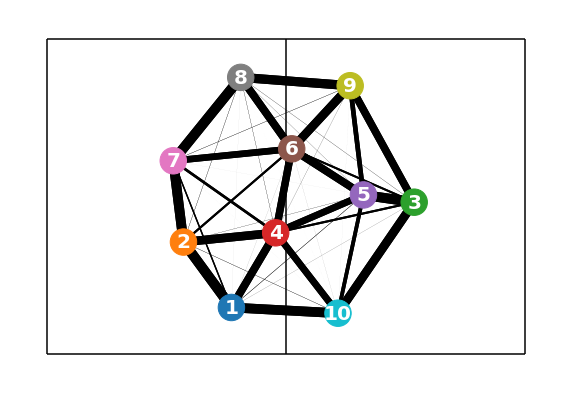

In [106]:
visualize_formation(mean_coords, mean_edge_mat)

In [25]:
MAX_SR = 0.5

fgp_files = [f for f in os.listdir(SUBDIR_FGP) if f.endswith('.csv')]
form_records = []

for fgp_file in tqdm(fgp_files):
    fgp_path = os.path.join(SUBDIR_FGP, fgp_file)
    fgp_df = pd.read_csv(fgp_path, sep=',', header=0)
    activity_id = int(os.path.splitext(fgp_file)[0])

    for i in fgp_df['session'].unique():
        period_fgp_df = fgp_df[(fgp_df['session'] == i) & (fgp_df['switch_rate'] <= MAX_SR)]
        
        role_x = period_fgp_df.pivot_table(values='x_norm', index='datetime', columns='role', aggfunc='first')
        role_y = period_fgp_df.pivot_table(values='y_norm', index='datetime', columns='role', aggfunc='first')
        role_coords = np.dstack([role_x.dropna().values, role_y.dropna().values])
        if role_coords.shape[0] < 600 or role_coords.shape[1] < 10:
            continue
        mean_coords = role_coords.mean(axis=0).round()

        edge_mats = []
        for coords in role_coords:
            edge_mats.append(delaunay_edge_mat(coords))
        edge_mats = np.stack(edge_mats, axis=0)
        mean_edge_mat = edge_mats.mean(axis=0).round(3)

        form_record = {'session_id': f'{activity_id}-{int(i)}', 'coords': mean_coords, 'edge_mat': mean_edge_mat}
        form_records.append(form_record)
    
pd.DataFrame(form_records)

100%|████████████████████████████████████████████████████████████████████████████████| 259/259 [25:26<00:00,  5.89s/it]


,session_id,coords,adj_mat
0,12864-1,"[[-729.0, 1645.0], [-1351.0, 634.0], [1043.0, ...","[[0.0, 0.984, 0.94, 0.248, 0.03, 0.782, 0.242,..."
1,12868-1,"[[-831.0, -1680.0], [-56.0, 133.0], [-367.0, -...","[[0.0, 0.387, 0.647, 0.994, 0.12, 0.032, 0.202..."
2,12868-2,"[[-943.0, -1966.0], [-138.0, 595.0], [-246.0, ...","[[0.0, 0.153, 0.87, 0.996, 0.236, 0.029, 0.006..."
3,12870-1,"[[-1426.0, 38.0], [467.0, -1122.0], [-300.0, 4...","[[0.0, 0.208, 0.88, 0.085, 0.357, 0.972, 0.306..."
4,12870-2,"[[280.0, -897.0], [-219.0, 178.0], [1018.0, -1...","[[0.0, 0.887, 0.844, 0.033, 0.434, 0.971, 0.69..."
...,...,...,...
439,22419-2,"[[-724.0, -2086.0], [-1577.0, 803.0], [-123.0,...","[[0.0, 0.274, 0.085, 0.326, 0.975, 0.011, 0.77..."
440,22664-1,"[[-652.0, -1861.0], [-1356.0, 674.0], [-694.0,...","[[0.0, 0.18, 0.199, 0.069, 0.008, 0.695, 0.205..."
441,22664-2,"[[-786.0, -1578.0], [-1123.0, 776.0], [-1368.0...","[[0.0, 0.096, 0.454, 0.092, 0.012, 0.411, 0.55..."
442,22875-1,"[[-428.0, 1607.0], [-213.0, 630.0], [1402.0, -...","[[0.0, 0.923, 0.046, 0.006, 0.094, 0.52, 0.093..."


In [26]:
pd.DataFrame(form_records).to_pickle(os.path.join(SUBDIR_DATA, 'form_records.pkl'))

### Model Evaluation

In [6]:
form_files_2019 = os.listdir('data/2019_kleague/form_avg')
form_files_2020 = os.listdir('data/2020_kleague/form_avg')

form_records_list = []
for file in tqdm(form_files_2019):
    path = f'data/2019_kleague/form_avg/{file}'
    form_records = pd.read_pickle(path)
    form_records_list.append(form_records)
    
for file in tqdm(form_files_2020):
    path = f'data/2020_kleague/form_avg/{file}'
    form_records = pd.read_pickle(path)
    form_records_list.append(form_records)
    
form_records = pd.concat(form_records_list, ignore_index=True)
form_records

100%|███████████████████████████████████████████████████████████████████████████████| 250/250 [00:00<00:00, 295.11it/s]


,activity_id,session,form_period,start_dt,end_dt,duration,coords,edge_mat
0,1879,1,1,2019-03-01 16:00:00,2019-03-01 16:47:00,2820.0,"[[1710.0, -60.0], [133.0, -750.0], [1042.0, 18...","[[0.0, 0.715, 0.916, 0.974, 0.252, 0.023, 0.11..."
1,1879,2,2,2019-03-01 17:02:00,2019-03-01 17:53:00,3060.0,"[[1701.0, 24.0], [643.0, -620.0], [674.0, 1848...","[[0.0, 0.864, 0.888, 0.847, 0.266, 0.062, 0.1,..."
2,1882,1,1,2019-03-02 15:00:00,2019-03-02 15:46:00,2760.0,"[[-620.0, 1799.0], [-1366.0, -682.0], [-1525.0...","[[0.0, 0.124, 0.976, 0.907, 0.235, 0.99, 0.041..."
3,1882,2,2,2019-03-02 16:02:00,2019-03-02 16:44:00,2520.0,"[[-896.0, 1434.0], [-1231.0, -705.0], [-1400.0...","[[0.0, 0.253, 0.995, 0.764, 0.177, 0.942, 0.12..."
4,1882,2,3,2019-03-02 16:44:00,2019-03-02 16:51:00,420.0,"[[-810.0, 1465.0], [-1275.0, -668.0], [-1832.0...","[[0.0, 0.171, 0.986, 0.691, 0.231, 0.865, 0.12..."
...,...,...,...,...,...,...,...,...
861,22664,1,2,2020-11-25 19:26:20,2020-11-25 19:46:00,1180.0,"[[-700.0, -1753.0], [-1207.0, 701.0], [-983.0,...","[[0.0, 0.225, 0.29, 0.047, 0.01, 0.593, 0.233,..."
862,22664,2,3,2020-11-25 20:01:00,2020-11-25 20:54:00,3180.0,"[[-751.0, -1509.0], [-1394.0, 6.0], [-1094.0, ...","[[0.0, 0.444, 0.153, 0.106, 0.017, 0.429, 0.56..."
863,22875,1,1,2020-11-29 15:01:00,2020-11-29 15:48:00,2820.0,"[[-428.0, 1569.0], [-200.0, 618.0], [1359.0, -...","[[0.0, 0.908, 0.056, 0.009, 0.098, 0.525, 0.11..."
864,22875,2,2,2020-11-29 16:02:00,2020-11-29 16:51:20,2960.0,"[[-656.0, 1625.0], [-48.0, 443.0], [1368.0, -3...","[[0.0, 0.707, 0.087, 0.004, 0.094, 0.45, 0.258..."


In [43]:
form_records[form_records['activity_id'] == 13352]

,activity_id,session,form_period,start_dt,end_dt,duration,coords,edge_mat,cluster,form
447,13352,1,1,2020-05-26 19:00:00,2020-05-26 19:46:00,2760.0,"[[-1343.0, -1091.0], [-79.0, 514.0], [-1022.0,...","[[0.0, 0.274, 0.28, 0.924, 0.028, 0.002, 0.018...",0,343
448,13352,2,2,2020-05-26 20:01:00,2020-05-26 20:52:00,3060.0,"[[-1207.0, -1022.0], [-172.0, 680.0], [-1000.0...","[[0.0, 0.263, 0.243, 0.848, 0.027, 0.01, 0.024...",0,343


In [25]:
header = ['activity_id', 'session', 'phase', 'form_period', 'role_period', 'start_time']
role_records = fgp_df.groupby('role_period', as_index=False).first()[header[1:-1] + ['lapse']]
role_records['activity_id'] = activity_id
role_records['start_time'] = role_records['lapse'].apply(lambda x: int(x[:2]))
role_records[header]

,activity_id,session,phase,form_period,role_period,start_time
0,17985,1,1,1,1,0
1,17985,1,1,2,2,17
2,17985,2,2,3,3,0
3,17985,2,3,4,4,13
4,17985,2,4,4,5,40


In [28]:
forms_true = pd.read_csv('data/form_tags_true.csv', header=0).astype(int)
forms_pred = pd.read_csv('data/form_tags_pred.csv', header=0)
activity_ids = forms_true['activity_id'].unique()
forms_true

,activity_id,session,start_time,end_time,formation
0,2310,1,0,20,4231
1,2310,1,20,46,4231
2,2310,2,0,22,4231
3,2310,2,22,42,4231
4,2310,2,42,51,433
...,...,...,...,...,...
144,21689,2,39,50,352
145,21704,1,0,47,433
146,21704,2,0,5,433
147,21704,2,5,11,433


In [30]:
activity_ids = forms_true['activity_id'].unique()
header = ['activity_id', 'session', 'phase', 'form_period', 'role_period',
          'start_time', 'end_time', 'duration']

In [41]:
fgp_files_2019 = os.listdir('data/2019_kleague/fgp_avg')
fgp_files_2020 = os.listdir('data/2020_kleague/fgp_avg')

role_period_list = []
for file in tqdm(fgp_files_2019):
    activity_id = int(file.split('.')[0])
    if activity_id not in activity_ids:
        continue
    path = f'data/2019_kleague/fgp_avg/{file}'
    fgp_df = pd.read_csv(path, header=0, encoding='utf-8-sig')
    # count += len(fgp_df['role_period'].unique())
    grouped = fgp_df.groupby('role_period', as_index=False)
    match_role_periods = grouped.first()[header[1:5] + ['lapse']]
    match_role_periods['activity_id'] = activity_id
    match_role_periods['start_time'] = match_role_periods['lapse'].apply(lambda x: int(x[:2]))
    match_role_periods['end_time'] = grouped['lapse'].last().apply(lambda x: int(x[:2]))
    start_dt = grouped
    role_period_list.append(match_role_periods[header[:-1]])

for file in tqdm(fgp_files_2020):
    activity_id = int(file.split('.')[0])
    if activity_id not in activity_ids:
        continue
    path = f'data/2020_kleague/fgp_avg/{file}'
    fgp_df = pd.read_csv(path, header=0, encoding='utf-8-sig')
    # count += len(fgp_df['role_period'].unique())
    grouped = fgp_df.groupby('role_period', as_index=False)
    match_role_periods = grouped.first()[header[1:5] + ['lapse']]
    match_role_periods['activity_id'] = activity_id
    match_role_periods['start_time'] = match_role_periods['lapse'].apply(lambda x: int(x[:2]))
    match_role_periods['end_time'] = grouped['lapse'].last().apply(lambda x: int(x[:2]))
    start_dt = grouped
    role_period_list.append(match_role_periods[header[:-1]])
    
role_periods = pd.concat(role_period_list, axis=0, ignore_index=True).astype(int)
role_periods

  5%|███▉                                                                             | 10/207 [00:00<00:03, 58.29it/s]


TypeError: cannot convert the series to <class 'int'>

In [42]:
role_periods = pd.read_csv('data/role_periods.csv', header=0)
role_periods

,activity_id,session,phase,form_period,role_period,start_time
0,2310,1,1,1,1,0
1,2310,1,1,1,2,35
2,2310,2,2,2,3,0
3,2310,2,3,2,4,22
4,2310,2,4,2,5,42
...,...,...,...,...,...,...
148,21704,1,1,1,3,23
149,21704,1,1,1,4,31
150,21704,2,2,2,5,0
151,21704,2,2,2,6,6


In [44]:
cols = ['activity_id', 'form_period', 'session', 'start_time']
form_periods = role_periods.groupby(cols[:2], as_index=False).first()[cols]
forms_pred = pd.merge(form_periods, form_records)

In [57]:
forms_pred = pd.merge(role_periods, form_records[['activity_id', 'session', 'form_period', 'form']])
forms_pred.to_csv('data/form_tags_pred.csv', index=False, encoding='utf-8-sig')

In [37]:
role_period_df.to_csv('data/role_periods.csv', index=False, encoding='utf-8-sig')

In [288]:
session_ids = form_records.apply(lambda x: f"{x['activity_id']}-{x['session']}", axis=1)
session_ids.unique().shape

(809,)

In [120]:
forms_true = pd.read_csv('data/form_tags_true.csv', header=0)
forms_pred = pd.read_csv('data/form_tags_pred.csv', header=0)
forms_pred

,activity_id,session,phase,form_period,role_period,start_time,end_time,formation
0,2310,1,1,1,1,0,35,442
1,2310,1,1,1,2,35,46,442
2,2310,2,2,2,3,0,22,343
3,2310,2,3,2,4,22,42,343
4,2310,2,4,2,5,42,51,343
...,...,...,...,...,...,...,...,...
147,21704,1,1,1,3,23,31,4231
148,21704,1,1,1,4,31,47,4231
149,21704,2,2,2,5,0,6,442
150,21704,2,2,2,6,6,11,442


In [70]:
forms_pred['end_time'] = forms_pred['start_time'].shift(-1)
forms_pred.iat[-1, -1] = 0
forms_pred.loc[forms_pred['end_time'] == 0, 'end_time'] = forms_true.groupby(['activity_id', 'session'])['end_time'].last().values
forms_pred['end_time'] = forms_pred['end_time'].astype(int)
forms_pred.iloc[:10]

,activity_id,session,phase,form_period,role_period,start_time,form,end_time
0,2310,1,1,1,1,0,442,35
1,2310,1,1,1,2,35,442,46
2,2310,2,2,2,3,0,343,22
3,2310,2,3,2,4,22,343,42
4,2310,2,4,2,5,42,343,51
5,3447,1,1,1,1,0,352,32
6,3447,1,2,1,2,32,352,47
7,3447,2,3,2,3,0,352,36
8,3447,2,4,2,4,36,352,50
9,4898,1,1,1,1,0,442,37


In [71]:
forms_true.to_csv('data/form_tags_true.csv', index=False)
forms_pred.to_csv('data/form_tags_pred.csv', index=False)

In [121]:
mins_header = ['activity_id', 'session', 'start_time', 'formation']
mins_true = []
for i in forms_true.index:
    period_true = forms_true.iloc[i]
    start_time = period_true['start_time']
    end_time = period_true['end_time']
    duration = end_time - start_time
    period_mins_true = pd.DataFrame(
        np.repeat(period_true[mins_header].values[np.newaxis], duration, axis=0), columns=mins_header
    )
    period_mins_true['start_time'] = np.arange(start_time, end_time)
    mins_true.append(period_mins_true)
mins_true = pd.concat(mins_true, axis=0, ignore_index=True)
mins_true['formation'] = mins_true['formation'].astype(str)
mins_true

,activity_id,session,start_time,formation
0,2310,1,0,442
1,2310,1,1,442
2,2310,1,2,442
3,2310,1,3,442
4,2310,1,4,442
...,...,...,...,...
2675,21704,2,45,442
2676,21704,2,46,442
2677,21704,2,47,442
2678,21704,2,48,442


In [122]:
mins_pred = []
for i in forms_pred.index:
    period_pred = forms_pred.iloc[i]
    start_time = period_pred['start_time']
    end_time = period_pred['end_time']
    duration = end_time - start_time
    period_mins_pred = pd.DataFrame(
        np.repeat(period_pred[mins_header].values[np.newaxis], duration, axis=0), columns=mins_header
    )
    period_mins_pred['start_time'] = np.arange(start_time, end_time)
    mins_pred.append(period_mins_pred)
mins_pred = pd.concat(mins_pred, axis=0, ignore_index=True)
mins_pred

,activity_id,session,start_time,formation
0,2310,1,0,442
1,2310,1,1,442
2,2310,1,2,442
3,2310,1,3,442
4,2310,1,4,442
...,...,...,...,...
2675,21704,2,45,442
2676,21704,2,46,442
2677,21704,2,47,442
2678,21704,2,48,442


In [123]:
pd.merge(mins_true, mins_pred)

,activity_id,session,start_time,formation
0,2310,1,0,442
1,2310,1,1,442
2,2310,1,2,442
3,2310,1,3,442
4,2310,1,4,442
...,...,...,...,...
2042,21704,2,45,442
2043,21704,2,46,442
2044,21704,2,47,442
2045,21704,2,48,442


In [125]:
2047 / 2680

0.7638059701492538

In [118]:
confusion_matrix(
    mins_true['formation'].values, mins_pred['formation'].values, labels=formations
)

array([[371,  13,   0,  11,  85,   0,   1],
       [ 60, 272, 165,  42,   0,   0,  90],
       [156, 103, 150,   0,  47,   0,   0],
       [  0, 286,  99, 370,  13,  48,  57],
       [ 50,   4,  25,  22, 125,   0,   0],
       [  0,  10,   5,   0,   0,   0,   0],
       [  0,   0,   0,   0,   0,   0,   0]], dtype=int64)

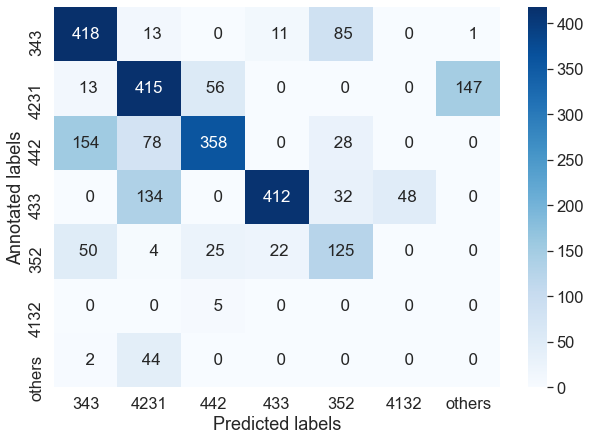

In [128]:
from sklearn.metrics import confusion_matrix
import seaborn as sn

formations = ['343', '4231', '442', '433', '352', '4132', 'others']
conf_mat = confusion_matrix(
    mins_true['formation'].values, mins_pred['formation'].values, labels=formations
)
conf_mat = pd.DataFrame(conf_mat, index=formations, columns=formations)

plt.figure(figsize = (10,7))
sn.set(font_scale=1.5)
sn.heatmap(conf_mat, cmap='Blues', annot=True, fmt='3d', annot_kws={"size": 17, })
plt.xlabel("Predicted labels")
plt.ylabel("Annotated labels")
plt.savefig('form_conf.pdf',bbox_inches='tight')

### Formation Clustering

In [9]:
def delaunay_dist(form1, form2):
    cost_mat = distance_matrix(form1['coords'], form2['coords'])
    _, perm = linear_sum_assignment(cost_mat)
    edge_mat1 = form1['edge_mat']
    edge_mat2 = form2['edge_mat'][perm][:, perm]
    return np.abs(edge_mat1 - edge_mat2).sum()

In [10]:
n = len(form_records)
dist_mat = np.zeros((n, n))

for i, j in tqdm(itertools.product(range(n), range(n))):
    if i >= j:
        continue
        
    form1 = form_records.iloc[i]
    form2 = form_records.iloc[j]
    assign_cost_mat = distance_matrix(form1['coords'], form2['coords'])
    _, perm = linear_sum_assignment(assign_cost_mat)
    
    edge_mat1 = form1['edge_mat']
    edge_mat2 = form2['edge_mat'][perm][:, perm]
    dist_mat[i, j] = np.abs(edge_mat1 - edge_mat2).sum()

dist_mat = dist_mat + dist_mat.T
dist_mat

749956it [03:27, 3612.29it/s] 


array([[ 0.   ,  6.426, 12.976, ..., 11.148, 12.276, 15.916],
       [ 6.426,  0.   , 16.206, ..., 15.702, 12.258, 12.858],
       [12.976, 16.206,  0.   , ...,  8.836,  9.824, 13.488],
       ...,
       [11.148, 15.702,  8.836, ...,  0.   ,  8.744, 12.508],
       [12.276, 12.258,  9.824, ...,  8.744,  0.   ,  8.508],
       [15.916, 12.858, 13.488, ..., 12.508,  8.508,  0.   ]])

In [12]:
pd.DataFrame(dist_mat).to_csv('formationtools/dist_mat.csv', header=False, index=False)

In [7]:
dist_mat = pd.read_csv('formationtools/dist_mat.csv', header=None).values
dist_mat

array([[ 0.   ,  6.426, 12.976, ..., 11.148, 12.276, 15.916],
       [ 6.426,  0.   , 16.206, ..., 15.702, 12.258, 12.858],
       [12.976, 16.206,  0.   , ...,  8.836,  9.824, 13.488],
       ...,
       [11.148, 15.702,  8.836, ...,  0.   ,  8.744, 12.508],
       [12.276, 12.258,  9.824, ...,  8.744,  0.   ,  8.508],
       [15.916, 12.858, 13.488, ..., 12.508,  8.508,  0.   ]])

In [8]:
model = AgglomerativeClustering(n_clusters=18, affinity='precomputed', linkage='average')
model = model.fit(dist_mat)
counter = Counter(model.labels_)
outliers = []
for cluster, count in counter.items():
    if count < 15:
        outliers.append(cluster)
form_records['cluster'] = np.where(
    np.isin(model.labels_, outliers), -1, model.labels_
)
# form_records['cluster'] = model.labels_
form_records['cluster'].value_counts()

 3     341
 0     177
 14    143
 17    103
 2      61
-1      41
Name: cluster, dtype: int64

In [9]:
c3_idxs = form_records[form_records['cluster'] == 3].index
dist_mat_c3 = dist_mat[c3_idxs][:, c3_idxs]
dist_mat_c3.shape

(341, 341)

In [10]:
submodel = AgglomerativeClustering(n_clusters=15, affinity='precomputed', linkage='average')
submodel = submodel.fit(dist_mat_c3)
counter = Counter(submodel.labels_)
outliers = []
for cluster, count in counter.items():
    if count < 15:
        outliers.append(cluster)
form_records.loc[c3_idxs, 'cluster'] = np.where(
    np.isin(submodel.labels_, outliers), -1, submodel.labels_ + 18
)
# form_records.loc[c3_idxs, 'cluster'] = model.labels_ + 18
form_records.loc[c3_idxs, 'cluster'].value_counts()

 21    140
 20     81
 22     57
-1      33
 27     30
Name: cluster, dtype: int64

In [11]:
def visualize_cluster(form_records, group, group_label='cluster'):
    coords_series = form_records[form_records[group_label] == group]['coords']
    
    # coords_list = []
    # for coords in coords_df:
    #     assign_cost_mat = distance_matrix(mean_coords, coords)
    #     _, perm = linear_sum_assignment(assign_cost_mat)
    #     coords_list.append(coords[perm])
    # coords_arr = np.stack(coords_list)
    
    coords_df = pd.DataFrame(np.vstack(coords_series.values))
    coloring_model = AgglomerativeClustering(n_clusters=10).fit(coords_df.values)
    coords_df['color'] = coloring_model.labels_
    mean_coords = coords_df.groupby('color').mean().values
    
    for i in range(3):
        coords_list = []
        for coords in coords_series:
            assign_cost_mat = distance_matrix(mean_coords, coords)
            _, perm = linear_sum_assignment(assign_cost_mat)
            coords_list.append(coords[perm])
        # coords_aligned = np.dstack(coords_list)
        coords_aligned = np.stack(coords_list)
        mean_coords = coords_aligned.mean(axis=0)

    plt.figure(figsize=(10, 7))
    for r in range(10):
        plt.scatter(coords_aligned[:, r, 0], coords_aligned[:, r, 1], s=100, alpha=0.5)
    xlim = 3000
    ylim = 3000
    plt.xlim(-xlim - 500, xlim + 500)
    plt.ylim(-ylim - 500, ylim + 500)
    plt.vlines([-xlim, 0, xlim], ymin=-ylim, ymax=ylim, color='k', zorder=0)
    plt.hlines([-ylim, ylim], xmin=-xlim, xmax=xlim, color='k', zorder=0)
    plt.axis('off')

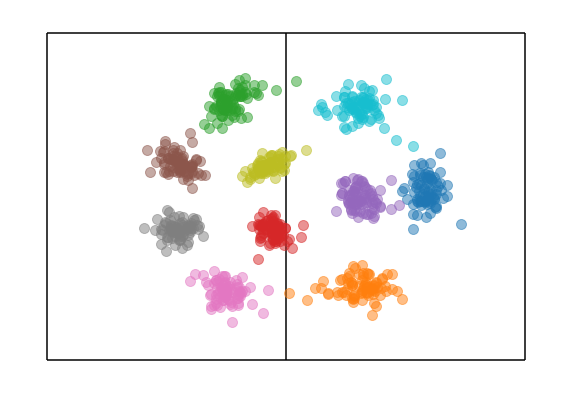

In [12]:
visualize_cluster(form_records, 20)

In [13]:
clus_to_form = {
    0: '343', 17: '352', 21: '442', 14: '433',
    2: '4132', 20: '4231', 22: '4231', 27: '4231', -1: 'others'
}
form_records['form'] = form_records['cluster'].apply(lambda x: clus_to_form[x])
form_records

,activity_id,session,form_period,start_dt,end_dt,duration,coords,edge_mat,cluster,form
0,1879,1,1,2019-03-01 16:00:00,2019-03-01 16:47:00,2820.0,"[[1710.0, -60.0], [133.0, -750.0], [1042.0, 18...","[[0.0, 0.715, 0.916, 0.974, 0.252, 0.023, 0.11...",14,433
1,1879,2,2,2019-03-01 17:02:00,2019-03-01 17:53:00,3060.0,"[[1701.0, 24.0], [643.0, -620.0], [674.0, 1848...","[[0.0, 0.864, 0.888, 0.847, 0.266, 0.062, 0.1,...",14,433
2,1882,1,1,2019-03-02 15:00:00,2019-03-02 15:46:00,2760.0,"[[-620.0, 1799.0], [-1366.0, -682.0], [-1525.0...","[[0.0, 0.124, 0.976, 0.907, 0.235, 0.99, 0.041...",-1,others
3,1882,2,2,2019-03-02 16:02:00,2019-03-02 16:44:00,2520.0,"[[-896.0, 1434.0], [-1231.0, -705.0], [-1400.0...","[[0.0, 0.253, 0.995, 0.764, 0.177, 0.942, 0.12...",2,4132
4,1882,2,3,2019-03-02 16:44:00,2019-03-02 16:51:00,420.0,"[[-810.0, 1465.0], [-1275.0, -668.0], [-1832.0...","[[0.0, 0.171, 0.986, 0.691, 0.231, 0.865, 0.12...",2,4132
...,...,...,...,...,...,...,...,...,...,...
861,22664,1,2,2020-11-25 19:26:20,2020-11-25 19:46:00,1180.0,"[[-700.0, -1753.0], [-1207.0, 701.0], [-983.0,...","[[0.0, 0.225, 0.29, 0.047, 0.01, 0.593, 0.233,...",-1,others
862,22664,2,3,2020-11-25 20:01:00,2020-11-25 20:54:00,3180.0,"[[-751.0, -1509.0], [-1394.0, 6.0], [-1094.0, ...","[[0.0, 0.444, 0.153, 0.106, 0.017, 0.429, 0.56...",-1,others
863,22875,1,1,2020-11-29 15:01:00,2020-11-29 15:48:00,2820.0,"[[-428.0, 1569.0], [-200.0, 618.0], [1359.0, -...","[[0.0, 0.908, 0.056, 0.009, 0.098, 0.525, 0.11...",27,4231
864,22875,2,2,2020-11-29 16:02:00,2020-11-29 16:51:20,2960.0,"[[-656.0, 1625.0], [-48.0, 443.0], [1368.0, -3...","[[0.0, 0.707, 0.087, 0.004, 0.094, 0.45, 0.258...",21,442


In [14]:
total_dur = form_records['duration'].sum()
form_durs = form_records.groupby('form')['duration'].sum()

counts = form_records['form'].value_counts()
form_props = (form_durs / total_dur).round(4)
form_mean_durs = (form_durs / form_records['form'].value_counts()).round(1)

counts.name = 'count'
form_props.name = 'proportion'
form_mean_durs.name = 'mean_dur'

pd.concat([counts, form_props, form_mean_durs], axis=1)

,count,proportion,mean_dur
343,177,0.2103,2770.4
4231,168,0.2001,2777.3
433,143,0.1669,2722.0
442,140,0.1670,2782.6
352,103,0.1185,2683.5
others,74,0.0667,2101.2
4132,61,0.0706,2698.5


In [278]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram
    
    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_, counts]).astype(float)
    color_threshold = 0.75 * max(linkage_matrix[:, 2])

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, color_threshold=color_threshold, **kwargs)

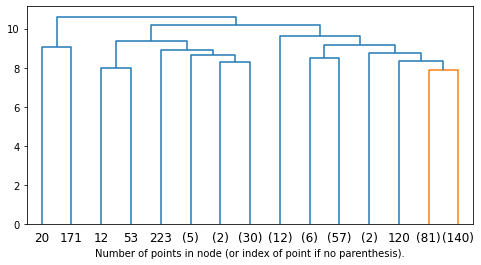

In [281]:
plt.figure(figsize=(8, 4))
model = AgglomerativeClustering(
    n_clusters=None, affinity='precomputed', linkage='average', distance_threshold=0
)
model.fit(dist_mat_c3)
plot_dendrogram(model, truncate_mode='lastp', p=15)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

### Calculating and Visualizing Deformations

In [8]:
activity_id = 17985
fgp_path = f'data/2020_kleague/fgp_avg/{activity_id}.csv'
fgp_df = pd.read_csv(fgp_path, sep=',', header=0)
fgp_df

,player_id,squad_num,position,player_name,datetime,session,lapse,phase,form_period,role_period,x,y,x_norm,y_norm,role,base_role,switch_rate
0,4181,2,DF,Dahwon Jung,2020-09-05 19:00:01,1,00:01.0,1,1,1,4809.0,1206.0,-58.0,-2862.6,1,1,0.2
1,4181,2,DF,Dahwon Jung,2020-09-05 19:00:02,1,00:02.0,1,1,1,4836.0,1082.0,-37.5,-2982.2,1,1,0.0
2,4181,2,DF,Dahwon Jung,2020-09-05 19:00:03,1,00:03.0,1,1,1,4799.0,1009.0,-112.2,-3034.6,1,1,0.0
3,4181,2,DF,Dahwon Jung,2020-09-05 19:00:04,1,00:04.0,1,1,1,4823.0,1034.0,-155.1,-3033.7,1,1,0.0
4,4181,2,DF,Dahwon Jung,2020-09-05 19:00:05,1,00:05.0,1,1,1,4860.0,1134.0,-185.7,-3017.1,1,1,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56352,4142,99,FW,Jaegun Lee,2020-09-05 20:48:56,2,47:56.0,4,4,5,2624.0,1881.0,1072.1,-1456.9,10,10,0.5
56353,4142,99,FW,Jaegun Lee,2020-09-05 20:48:57,2,47:57.0,4,4,5,2438.0,1801.0,1010.5,-1469.9,10,10,0.5
56354,4142,99,FW,Jaegun Lee,2020-09-05 20:48:58,2,47:58.0,4,4,5,2269.0,1820.0,884.9,-1349.0,10,10,0.5
56355,4142,99,FW,Jaegun Lee,2020-09-05 20:48:59,2,47:59.0,4,4,5,2171.0,1959.0,781.4,-1169.7,10,10,0.5


In [9]:
role_records = pd.read_pickle(os.path.join(SUBDIR_DATA, 'role_records.pkl'))
match_role_records = role_records[role_records['activity_id'] == activity_id]

In [10]:
role_locs = match_role_records[['session', 'role', 'x', 'y']]
role_locs = pd.merge(
    fgp_df[['datetime', 'session', 'player_id', 'base_role', 'x_norm', 'y_norm']],
    role_locs.rename(columns={'role': 'base_role', 'x': 'base_x', 'y': 'base_y'})
)
deform_x = role_locs['x_norm'] - role_locs['base_x']
deform_y = role_locs['y_norm'] - role_locs['base_y']
role_locs['deform'] = pd.concat([deform_x, deform_y], axis=1).apply(np.linalg.norm, axis=1)
role_locs

,datetime,session,player_id,base_role,x_norm,y_norm,base_x,base_y,deform
0,2020-09-05 19:00:01,1,4181,1,-58.0,-2862.6,-730.571163,-1700.066558,1343.069608
1,2020-09-05 19:00:02,1,4181,1,-37.5,-2982.2,-730.571163,-1700.066558,1457.468284
2,2020-09-05 19:00:03,1,4181,1,-112.2,-3034.6,-730.571163,-1700.066558,1470.837313
3,2020-09-05 19:00:04,1,4181,1,-155.1,-3033.7,-730.571163,-1700.066558,1452.496202
4,2020-09-05 19:00:05,1,4181,1,-185.7,-3017.1,-730.571163,-1700.066558,1425.293539
...,...,...,...,...,...,...,...,...,...
56352,2020-09-05 20:48:56,2,4142,10,1072.1,-1456.9,840.281120,-1702.564448,337.773614
56353,2020-09-05 20:48:57,2,4142,10,1010.5,-1469.9,840.281120,-1702.564448,288.283216
56354,2020-09-05 20:48:58,2,4142,10,884.9,-1349.0,840.281120,-1702.564448,356.368719
56355,2020-09-05 20:48:59,2,4142,10,781.4,-1169.7,840.281120,-1702.564448,536.107738


In [11]:
x_norm = role_locs.pivot_table(values='x_norm', index='datetime', columns='base_role', aggfunc='first')
y_norm = role_locs.pivot_table(values='y_norm', index='datetime', columns='base_role', aggfunc='first')

In [12]:
player_ids = fgp_df['player_id'].unique()
roles = np.sort(fgp_df['role'].unique())
colors = plt.cm.tab10(range(10))

fig, ax = plt.subplots()
fig.set_size_inches(10, 7)
ax.set(xlim=(-5000, 5000), ylim=(-3500, 3500))

session = role_locs.at[0, 'session']
base_x = match_role_records.loc[match_role_records['session'] == session, 'x']
base_y = match_role_records.loc[match_role_records['session'] == session, 'y']

temp_scat = ax.scatter(x_norm.iloc[0], y_norm.iloc[0], s=200, c=roles, cmap='tab10')
base_scat = ax.scatter(base_x, base_y, s=300, c=roles, cmap='tab10', marker='s')
lines = dict()
anots = dict()
for r in roles:
    lines[r], = ax.plot([x_norm[r].iloc[0], base_x.iloc[r-1]],
                        [y_norm[r].iloc[0], base_y.iloc[r-1]], color=colors[r-1])
    anots[r] = ax.annotate(r, xy=(base_x.iloc[r-1], base_y.iloc[r-1]), ha='center', va='center',
                           color='w', fontsize=12, fontweight='bold')
    anots[r].set_animated(True)
    
def animate(i):
    t = i + 200
    global session, base_x, base_y
    temp_session = role_locs.at[t, 'session']
    if temp_session != session:
        session = temp_session
        base_x = match_role_records.loc[match_role_records['session'] == session, 'x']
        base_y = match_role_records.loc[match_role_records['session'] == session, 'y']
        base_scat.set_offsets(pd.concat([base_x, base_y], axis=1).values)
        for r in roles:
            anots[r].set_position((base_x.iloc[r-1], base_y.iloc[r-1]))
    
    temp_scat.set_offsets(np.array([x_norm.iloc[t], y_norm.iloc[t]]).T)
    for r in roles:
        lines[r].set_data([x_norm[r].iloc[t], base_x.iloc[r-1]],
                          [y_norm[r].iloc[t], base_y.iloc[r-1]])   

ani = animation.FuncAnimation(fig, animate, frames=200, interval=250)
plt.close(fig)
HTML(ani.to_jshtml())

In [83]:
ani.save('formationtools/deform.gif', writer='pillow', fps=4)

### Additional Visualization

In [107]:
def delaunay_generator(role_records):
    for activity_id in role_records['activity_id'].unique():
        match_roles = role_records[role_records['activity_id'] == activity_id]
        for session in match_roles['session'].unique():
            session_roles = match_roles[match_roles['session'] == session]
            if len(session_role_records) != 10:
                continue
            yield activity_id, session, Delaunay(session_roles[['x', 'y']])

In [120]:
for i in role_records.index:
    role_records.at[i, 'distn'].cov = role_records.at[i, 'distn'].cov / 4

In [106]:
def random_sample_from_formation(role_distns, size=100):
    sample = np.vstack(role_distns.apply(lambda x: x.rvs(size=size)))
    sample = pd.DataFrame(sample, columns=['x', 'y'])
    return (sample / sample.std(axis=0)).values

In [121]:
samples = role_records.groupby('formation')['distn'].apply(random_sample_from_formation)

(-2.5, 2.5)

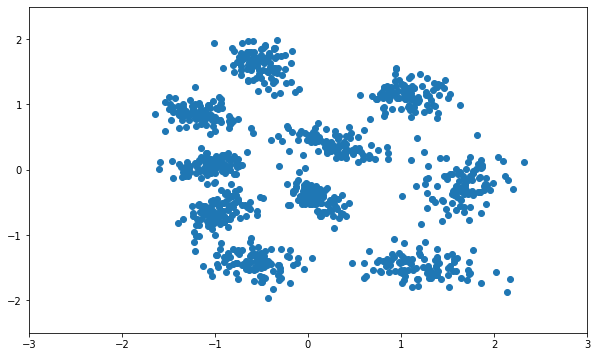

In [126]:
form = 5
plt.figure(figsize=(10, 6))
plt.scatter(samples[form][:, 0], samples[form][:, 1])
plt.xlim(-3, 3)
plt.ylim(-2.5, 2.5)

In [131]:
cost_mat = cdist(samples[4], samples[5])
row_idx, col_idx = linear_sum_assignment(cost_mat)
cost_mat[row_idx, col_idx].sum() / 1000

0.22981908335181434